![Nuclio logo](https://nuclio.school/wp-content/uploads/2018/12/nucleoDS-newBlack.png)

# Proyecto final - Data Analytics y Business Intelligence

Recibimos dos datasets:

1. `renfe.csv`: Información de búsquedas de billetes que se hicieron en la página de Renfe.
2. `coordenadas_ciudades.csv`: Latitud y longitud de provincias españolas.

Queremos usar estos datasets para un modelo de Machine Learning que utilizaremos para predecir los precios de los billetes. Y, para ello, necesitamos limpiar, explorar y pre-procesar el dataset.

## Reglas de juego

1. El proyecto se debe entregar en grupos de dos o individualmente. 
2. Cada respuesta correcta suma un punto.
3. La calificación final consistirá en la suma de todos los puntos obtenidos sobre el total de puntos posibles.


## Diccionario de datos

Esta es la información provista:

### `renfe.csv`
- `FECHA_CONSULTA`: Fecha en la que se consultó la página.
- `FECHA_INICIO`: Fecha de inicio del trayecto.
- `FECHA_FIN`: Fecha de finalización del trayecto.
- `CIUDAD_ORIGEN`: Ciudad de origen del trayecto.
- `CIUDAD_DESTINO`: Ciudad destino del trayecto.
- `TIPO_TREN`: Tipo de tren.
- `TIPO_TARIFA`: Tipo de tarifa del billete.
- `CLASE`: Clase del asiento seleccionado.
- `PRECIO`: Precio del tren seleccionado.

### `coordenadas_ciudades.csv`
- `ciudad`: Nombre de la ciudad.
- `latitud`: Coordenada de latitud de la ciudad.
- `longitud`: Coordenada de longitud de la ciudad.

## Importar librerías

In [2]:
import pandas as pd
import plotly.express as px

## P0: Lee el dataset `renfe.csv`

In [3]:
df = pd.read_csv("data/renfe.csv", sep= ";")
df

,FECHA_CONSULTA,FECHA_INICIO,FECHA_FIN,CIUDAD_ORIGEN,CIUDAD_DESTINO,TIPO_TREN,TIPO_TARIFA,CLASE,PRECIO
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75
...,...,...,...,...,...,...,...,...,...
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30


## P1: Visualiza las primeras y las últimas filas del dataset

In [3]:
df.head() #Primeras filas

,FECHA_CONSULTA,FECHA_INICIO,FECHA_FIN,CIUDAD_ORIGEN,CIUDAD_DESTINO,TIPO_TREN,TIPO_TARIFA,CLASE,PRECIO
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75


In [4]:
df.tail() #Últimas filas

,FECHA_CONSULTA,FECHA_INICIO,FECHA_FIN,CIUDAD_ORIGEN,CIUDAD_DESTINO,TIPO_TREN,TIPO_TARIFA,CLASE,PRECIO
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30
383567,2019-05-27 15:04:14,2019-06-16 18:35:00,2019-06-16 20:21:00,VALENCIA,MADRID,AVE,Flexible,Turista,73.10


## P2: ¿Cuantas filas y columnas tiene el dataset?

In [5]:
df.shape #Tiene 383568 filas y 9 columnas

(383568, 9)

## P3: Cambia los nombres de todas las columnas a minúsculas

In [6]:
df.columns = df.columns.str.lower()
df.columns

Index(['fecha_consulta', 'fecha_inicio', 'fecha_fin', 'ciudad_origen',
       'ciudad_destino', 'tipo_tren', 'tipo_tarifa', 'clase', 'precio'],
      dtype='object')

In [7]:
df

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75
...,...,...,...,...,...,...,...,...,...
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30


## P4: Muestra los tipos de datos de cada columna

In [8]:
df.info(verbose= True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 383568 entries, 0 to 383567
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   fecha_consulta  383568 non-null  object 
 1   fecha_inicio    383568 non-null  object 
 2   fecha_fin       383568 non-null  object 
 3   ciudad_origen   383568 non-null  object 
 4   ciudad_destino  383568 non-null  object 
 5   tipo_tren       383568 non-null  object 
 6   tipo_tarifa     382225 non-null  object 
 7   clase           382225 non-null  object 
 8   precio          355038 non-null  float64
dtypes: float64(1), object(8)
memory usage: 26.3+ MB


## P5: Cambia los tipos de datos que creas que creas incorrectos, por los tipos adecuados

In [9]:
pd.set_option("display.float_format", "{:,.2f}".format)
df.describe()

,precio
count,"355,038.00"
mean,61.44
std,25.70
min,0.00
25%,41.20
50%,58.15
75%,76.30
max,342.80


In [10]:
df = df.assign(
    fecha_consulta=pd.to_datetime(df['fecha_consulta'], format="%Y-%m-%d %H:%M:%S"),
    fecha_inicio=pd.to_datetime(df['fecha_inicio'], format="%Y-%m-%d %H:%M:%S"),
    fecha_fin=pd.to_datetime(df['fecha_fin'], format="%Y-%m-%d %H:%M:%S")
)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 383568 entries, 0 to 383567
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   fecha_consulta  383568 non-null  datetime64[ns]
 1   fecha_inicio    383568 non-null  datetime64[ns]
 2   fecha_fin       383568 non-null  datetime64[ns]
 3   ciudad_origen   383568 non-null  object        
 4   ciudad_destino  383568 non-null  object        
 5   tipo_tren       383568 non-null  object        
 6   tipo_tarifa     382225 non-null  object        
 7   clase           382225 non-null  object        
 8   precio          355038 non-null  float64       
dtypes: datetime64[ns](3), float64(1), object(5)
memory usage: 26.3+ MB


## P6: Filas duplicadas

In [12]:
df.duplicated()

0         False
1         False
2         False
3         False
4         False
          ...  
383563    False
383564    False
383565    False
383566    False
383567    False
Length: 383568, dtype: bool

In [13]:
df.loc[df.duplicated(keep= False)]

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio
8530,2019-06-10 01:10:54,2019-07-07 21:03:00,2019-07-07 23:28:00,VALENCIA,MADRID,INTERCITY,Promo,Turista,43.75
9179,2019-08-17 03:22:19,2019-09-01 21:03:00,2019-09-01 23:28:00,VALENCIA,MADRID,INTERCITY,Flexible,Turista,NaN
14256,2019-05-03 05:33:32,2019-05-24 15:10:00,2019-05-24 17:20:00,MADRID,VALENCIA,INTERCITY,Promo,Turista,43.75
24392,2019-05-15 21:26:30,2019-06-23 21:05:00,2019-06-23 23:32:00,VALENCIA,MADRID,INTERCITY,NaN,NaN,NaN
29786,2019-05-13 05:35:59,2019-05-26 17:30:00,2019-05-26 19:43:00,VALENCIA,MADRID,INTERCITY,Flexible,Turista,55.40
...,...,...,...,...,...,...,...,...,...
356200,2019-05-03 15:18:26,2019-05-24 15:10:00,2019-05-24 17:20:00,MADRID,VALENCIA,INTERCITY,Promo,Turista,43.75
362709,2019-06-22 07:11:59,2019-07-03 21:03:00,2019-07-03 23:28:00,VALENCIA,MADRID,INTERCITY,Promo,Turista,29.90
372763,2019-08-16 05:36:33,2019-08-16 21:03:00,2019-08-16 23:28:00,VALENCIA,MADRID,INTERCITY,Flexible,Turista,55.40
376617,2019-05-17 15:22:08,2019-07-11 21:03:00,2019-07-11 23:28:00,VALENCIA,MADRID,INTERCITY,NaN,NaN,NaN


### P6.1: ¿Cuántas filas duplicadas tiene el dataset?

In [14]:
df.duplicated().sum() #Hay 33 filas duplicadas

33

### P6.2: Quita las filas duplicadas

In [15]:
df.drop_duplicates(inplace= True)

In [16]:
df

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75
...,...,...,...,...,...,...,...,...,...
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30


## P7: Valores nulos y análisis de `precio`

In [17]:
df.isna().sum()

fecha_consulta        0
fecha_inicio          0
fecha_fin             0
ciudad_origen         0
ciudad_destino        0
tipo_tren             0
tipo_tarifa        1338
clase              1338
precio            28515
dtype: int64

In [18]:
df.precio.describe()

count   355,020.00
mean         61.44
std          25.70
min           0.00
25%          41.20
50%          58.15
75%          76.30
max         342.80
Name: precio, dtype: float64

### P7.1: ¿Que porcentaje de valores nulos hay por cada columna?

In [19]:
df.isna().mean()*100

fecha_consulta   0.00
fecha_inicio     0.00
fecha_fin        0.00
ciudad_origen    0.00
ciudad_destino   0.00
tipo_tren        0.00
tipo_tarifa      0.35
clase            0.35
precio           7.43
dtype: float64

In [20]:
df.tipo_tarifa.value_counts(dropna=False) #Comprobamos que los Nan sean informáticos de la columna tipo_tarifa

tipo_tarifa
Promo                      266484
Flexible                    82348
Adulto ida                  24007
Promo +                      9164
NaN                          1338
COD.PROMOCIONAL               168
Individual-Flexible            13
Mesa                            8
Doble Familiar-Flexible         3
4x100                           1
Grupos Ida                      1
Name: count, dtype: int64

In [21]:
df.clase.value_counts(dropna=False) #Comprobamos que los Nan sean informáticos de la columna clase

clase
Turista                     290733
Preferente                   37761
Turista Plus                 27069
Turista con enlace           23264
TuristaSólo plaza H           2724
NaN                           1338
PreferenteSólo plaza H         343
Cama Turista                   285
Cama G. Clase                   16
Turista PlusSólo plaza H         2
Name: count, dtype: int64

In [22]:
df.precio.value_counts(dropna=False) #Comprobamos que los Nan sean informáticos de la columna precio

precio
NaN       28515
85.10     18629
28.35     18409
76.30     17566
107.70    13762
          ...  
342.80        1
30.91         1
29.75         1
57.05         1
49.14         1
Name: count, Length: 293, dtype: int64

### P7.2: ¿Cual es el mínimo, percentiles importantes (25%, 50%, 75%) y el máximo de `precio`?

In [23]:
df.precio.describe()

count   355,020.00
mean         61.44
std          25.70
min           0.00
25%          41.20
50%          58.15
75%          76.30
max         342.80
Name: precio, dtype: float64

### P7.3: ¿Hay algo raro en el valor mínimo de `precio`? Quita las filas con ese valor del dataset

In [24]:
df.loc[df['precio']==0]

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio
121961,2019-06-17 09:01:21,2019-08-03 20:00:00,2019-08-03 23:10:00,BARCELONA,MADRID,AVE,4x100,Turista,0.00
136925,2019-06-13 01:13:29,2019-06-16 12:50:00,2019-06-16 15:45:00,BARCELONA,MADRID,AVE-TGV,Flexible,Preferente,0.00


In [25]:
df = df.loc[df['precio'] != 0]

In [26]:
df.loc[df['precio'] == 0] #Comprobamos que las hemos quitado

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio


In [27]:
df.shape

(383533, 9)

### P7.4: Reemplaza los valores nulos en `precio` por la media de esa columna

In [28]:
df.precio.isnull().sum()

28515

In [29]:
media_precio = df['precio'].mean()
filas_nulas = df['precio'].isnull()

In [30]:
df.loc[filas_nulas, 'precio'] = media_precio

In [31]:
assert df['precio'].notnull().all(), "Hay valores nulos en la columna 'precio'" #Comprobamos que no hay nulos ya en la columna "precio"

### P7.5: Quita las filas donde `clase` o `tipo_tarifa` sean nulos

In [32]:
df = df.dropna(subset=['clase', 'tipo_tarifa']).copy()
df

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75
...,...,...,...,...,...,...,...,...,...
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30


In [33]:
df.clase.isnull().sum() #Comprobamos que hemos borrado los nulos de la columna "clase"

0

In [34]:
df.tipo_tarifa.isnull().sum() #Comprobamos que hemos borrado los nulos de la columna "tipo_tarifa"

0

## P8: Tiempo de viaje

### P8.1: Calcula el tiempo de viaje en minutos (fecha_fin - fecha_inicio)

In [35]:
df.loc[:, 'tiempo_viaje'] = (df['fecha_fin'] - df['fecha_inicio']).dt.total_seconds() / 60
df

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio,tiempo_viaje
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20,158.00
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70,190.00
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30,150.00
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35,460.00
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75,179.00
...,...,...,...,...,...,...,...,...,...,...
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10,109.00
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45,190.00
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80,100.00
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30,141.00


### P8.2: Haz un histograma de la variable que acabas de crear (`tiempo_de_viaje`)

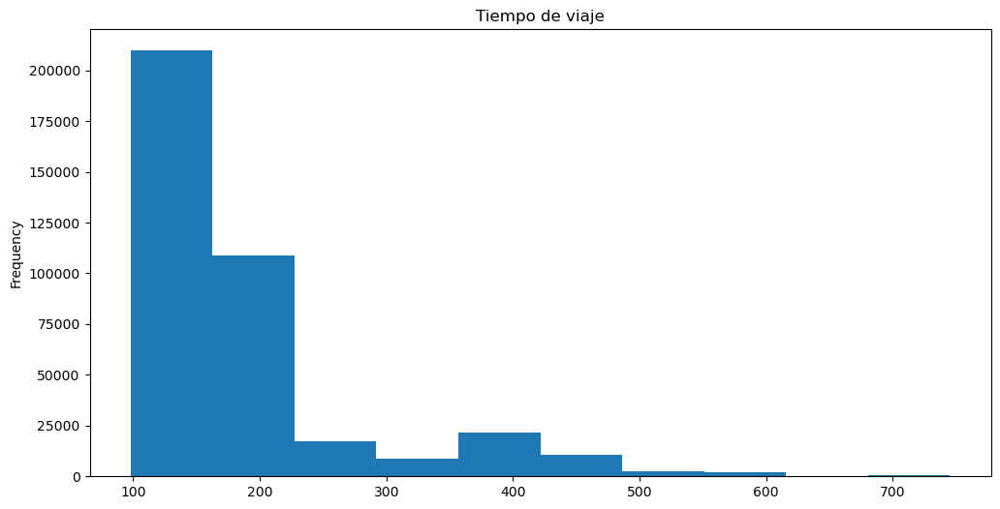

In [36]:
df.plot(
    kind="hist", 
    y="tiempo_viaje", 
    legend=None, 
    figsize=(12, 6), 
    title="Tiempo de viaje"
);

## P9: Extrae el día, el nombre del día, el mes y la hora de `fecha_inicio`

In [37]:
df = df.assign(
    dia_del_mes = df['fecha_inicio'].dt.day,
    nombre_del_dia = df['fecha_inicio'].dt.day_name(),
    mes = df['fecha_inicio'].dt.month,
    hora_del_dia = df['fecha_inicio'].dt.hour
)
df

,fecha_consulta,fecha_inicio,fecha_fin,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio,tiempo_viaje,dia_del_mes,nombre_del_dia,mes,hora_del_dia
0,2019-05-25 01:43:03,2019-06-28 20:36:00,2019-06-28 23:14:00,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20,158.00,28,Friday,6,20
1,2019-06-22 13:05:11,2019-07-14 10:00:00,2019-07-14 13:10:00,BARCELONA,MADRID,AVE,Flexible,Turista,107.70,190.00,14,Sunday,7,10
2,2019-04-17 06:24:03,2019-05-23 13:40:00,2019-05-23 16:10:00,SEVILLA,MADRID,AVE,Promo,Turista,47.30,150.00,23,Thursday,5,13
3,2019-05-10 21:21:59,2019-05-29 14:50:00,2019-05-29 22:30:00,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35,460.00,29,Wednesday,5,14
4,2019-05-09 19:43:37,2019-06-26 13:25:00,2019-06-26 16:24:00,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75,179.00,26,Wednesday,6,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
383563,2019-05-06 05:11:53,2019-05-10 19:40:00,2019-05-10 21:29:00,MADRID,VALENCIA,AVE,Flexible,Turista,73.10,109.00,10,Friday,5,19
383564,2019-06-19 21:48:56,2019-08-05 20:00:00,2019-08-05 23:10:00,BARCELONA,MADRID,AVE,Promo,Preferente,54.45,190.00,5,Monday,8,20
383565,2019-04-24 23:21:44,2019-04-29 16:15:00,2019-04-29 17:55:00,VALENCIA,MADRID,AVE,Promo,Turista,27.80,100.00,29,Monday,4,16
383566,2019-05-27 21:05:19,2019-07-07 15:00:00,2019-07-07 17:21:00,MADRID,SEVILLA,AVE,Promo,Turista,47.30,141.00,7,Sunday,7,15


## P10: Quita las columnas `fecha_consulta`, `fecha_inicio` y `fecha_fin` del dataset

In [38]:
df = df.drop(['fecha_consulta', 'fecha_inicio', 'fecha_fin'], axis=1)
df

,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio,tiempo_viaje,dia_del_mes,nombre_del_dia,mes,hora_del_dia
0,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20,158.00,28,Friday,6,20
1,BARCELONA,MADRID,AVE,Flexible,Turista,107.70,190.00,14,Sunday,7,10
2,SEVILLA,MADRID,AVE,Promo,Turista,47.30,150.00,23,Thursday,5,13
3,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35,460.00,29,Wednesday,5,14
4,MADRID,BARCELONA,AVE-TGV,Promo,Turista,66.75,179.00,26,Wednesday,6,13
...,...,...,...,...,...,...,...,...,...,...,...
383563,MADRID,VALENCIA,AVE,Flexible,Turista,73.10,109.00,10,Friday,5,19
383564,BARCELONA,MADRID,AVE,Promo,Preferente,54.45,190.00,5,Monday,8,20
383565,VALENCIA,MADRID,AVE,Promo,Turista,27.80,100.00,29,Monday,4,16
383566,MADRID,SEVILLA,AVE,Promo,Turista,47.30,141.00,7,Sunday,7,15


## P11: Lee el dataset `coordenadas_ciudades.csv` y únelo con al dataset que has procesado hasta ahora (utiliza `ciudad_destino` para el `join`)

In [39]:
df_coordenadas = pd.read_csv("coordenadas_ciudades.csv")
df_coordenadas

,ciudad,latitud,longitud
0,MADRID,40.42,-3.70
1,BARCELONA,41.38,2.18
2,SEVILLA,37.39,-6.00
3,VALENCIA,39.47,-0.38
4,PONFERRADA,42.55,-6.59


In [40]:
df_coordenadas.rename(columns={'ciudad': 'ciudad_destino'}, inplace=True)


In [41]:
df_full = df\
    .merge(df_coordenadas, how= "outer", on=["ciudad_destino"])
df_full

,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio,tiempo_viaje,dia_del_mes,nombre_del_dia,mes,hora_del_dia,latitud,longitud
0,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20,158.00,28,Friday,6,20,40.42,-3.70
1,BARCELONA,MADRID,AVE,Flexible,Turista,107.70,190.00,14,Sunday,7,10,40.42,-3.70
2,SEVILLA,MADRID,AVE,Promo,Turista,47.30,150.00,23,Thursday,5,13,40.42,-3.70
3,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35,460.00,29,Wednesday,5,14,40.42,-3.70
4,SEVILLA,MADRID,AVE,Promo,Turista,60.30,150.00,21,Sunday,7,8,40.42,-3.70
...,...,...,...,...,...,...,...,...,...,...,...,...,...
382190,MADRID,PONFERRADA,AVE-LD,Promo,Turista con enlace,31.20,252.00,4,Tuesday,6,14,42.55,-6.59
382191,MADRID,PONFERRADA,ALVIA,Promo,Turista,33.50,243.00,22,Monday,7,17,42.55,-6.59
382192,MADRID,PONFERRADA,AVE-LD,Promo,Turista con enlace,37.45,252.00,22,Wednesday,5,14,42.55,-6.59
382193,MADRID,PONFERRADA,LD,Flexible,Turista con enlace,57.00,252.00,27,Saturday,7,14,42.55,-6.59


## P12: Gráfica en un mapa el precio medio por ciudad de destino

In [42]:
import folium

In [43]:
df_precio_medio = df_full.groupby('ciudad_destino').agg({
    'precio': 'mean',
    'latitud': 'first',  
    'longitud': 'first'  
}).reset_index()
df_precio_medio

,ciudad_destino,precio,latitud,longitud
0,BARCELONA,85.36,41.38,2.18
1,MADRID,60.70,40.42,-3.70
2,PONFERRADA,45.65,42.55,-6.59
3,SEVILLA,58.82,37.39,-6.00
4,VALENCIA,42.64,39.47,-0.38


In [44]:
precio_mapa = folium.Map(location=[df_precio_medio['latitud'].iloc[0], df_precio_medio['longitud'].iloc[0]], zoom_start=5)

for index, row in df_precio_medio.iterrows():
    folium.Marker(
        location=[row['latitud'], row['longitud']],
        popup=f"{row['ciudad_destino']} - Precio Medio: {row['precio']:.2f} €",
        icon=folium.Icon(color='blue')
    ).add_to(precio_mapa)

precio_mapa


## P13: Haz una tabla de correlación, ¿hay variables númericas correlacionadas con el precio?

In [45]:
df_renfe_num = df_full[['precio', 'tiempo_viaje', 'dia_del_mes', 'mes', 'hora_del_dia', 'latitud', 'longitud']]

In [46]:
df_renfe_num.corr().style.background_gradient(cmap="RdYlBu")
#Observamos que las relaciones son muy pobres

,precio,tiempo_viaje,dia_del_mes,mes,hora_del_dia,latitud,longitud
precio,1.000000,-0.226549,0.031131,-0.179374,0.048910,0.219981,0.238098
tiempo_viaje,-0.226549,1.000000,-0.005520,-0.001939,-0.183787,0.128923,-0.018864
dia_del_mes,0.031131,-0.005520,1.000000,-0.292580,0.003301,0.001803,0.003051
mes,-0.179374,-0.001939,-0.292580,1.000000,-0.004581,-0.038777,-0.050877
hora_del_dia,0.048910,-0.183787,0.003301,-0.004581,1.000000,-0.009968,-0.007656
latitud,0.219981,0.128923,0.001803,-0.038777,-0.009968,1.000000,0.531514
longitud,0.238098,-0.018864,0.003051,-0.050877,-0.007656,0.531514,1.000000


## P14: Relación entre variables del dataset y `precio`

### P14.1: Haz un scatter plot de precio vs. tiempo de viaje

In [47]:
fig = px.scatter(df_full, x='tiempo_viaje', y='precio', color= 'tipo_tren', title='Tiempo de viaje vs. Precio')

fig.update_layout(xaxis_title='Tiempo de viaje (minutos)', yaxis_title='Precio (€)')

fig.show()

#Digamos que la relación entre estas dos variables es nula. Aparentemente los puntos no parecen seguir ningún patrón, es decir, no hay una asociación clara entre ambas variables. Ponemos color en función de la variable "tipo_tren" para poder encontrar cualquier otra relación entre los puntos.


### P14.2: Haz un boxplot de precio vs. dia de la semana

In [48]:
fig = px.box(df_full, 
             x='precio', 
             y='nombre_del_dia', 
             category_orders={'nombre_del_dia': ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']},
             title='Precio por día de la semana', 
             hover_name='ciudad_destino',
             labels={'precio': 'Precio', 'nombre_del_dia': 'Día de la semana'})

fig.show()


### P14.3: Grafica el precio medio por día de la semana

In [49]:
precio_medio_dia_semana = df_full.groupby('nombre_del_dia')['precio'].mean().round(2).reset_index().copy()
precio_medio_dia_semana

,nombre_del_dia,precio
0,Friday,65.38
1,Monday,61.05
2,Saturday,57.91
3,Sunday,67.22
4,Thursday,60.75
5,Tuesday,58.02
6,Wednesday,59.15


In [50]:
fig = px.bar(
    data_frame= precio_medio_dia_semana, 
    x= "nombre_del_dia", 
    y= "precio", 
    title="Precio medio por día de la semana",
    category_orders={'nombre_del_dia': ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']}
)
fig.update_layout(xaxis_title='Día de la semana', yaxis_title='Precio medio (€)')
fig.show()

## P15: Crea un nuevo dataframe donde apliques *one-hot-encoding* a las variables categoricas

In [51]:
df_categoricas = df_full[['ciudad_origen', 'ciudad_destino', 'tipo_tren', 'tipo_tarifa', 'clase', 'nombre_del_dia']].copy()

In [52]:
df_encoded = pd.get_dummies(df_categoricas).copy()

In [53]:
df_final = pd.concat([df_full, df_encoded], axis=1).copy()
df_final

,ciudad_origen,ciudad_destino,tipo_tren,tipo_tarifa,clase,precio,tiempo_viaje,dia_del_mes,nombre_del_dia,mes,...,clase_Turista PlusSólo plaza H,clase_Turista con enlace,clase_TuristaSólo plaza H,nombre_del_dia_Friday,nombre_del_dia_Monday,nombre_del_dia_Saturday,nombre_del_dia_Sunday,nombre_del_dia_Thursday,nombre_del_dia_Tuesday,nombre_del_dia_Wednesday
0,SEVILLA,MADRID,ALVIA,Flexible,Turista,67.20,158.00,28,Friday,6,...,False,False,False,True,False,False,False,False,False,False
1,BARCELONA,MADRID,AVE,Flexible,Turista,107.70,190.00,14,Sunday,7,...,False,False,False,False,False,False,True,False,False,False
2,SEVILLA,MADRID,AVE,Promo,Turista,47.30,150.00,23,Thursday,5,...,False,False,False,False,False,False,False,True,False,False
3,VALENCIA,MADRID,REGIONAL,Adulto ida,Turista,28.35,460.00,29,Wednesday,5,...,False,False,False,False,False,False,False,False,False,True
4,SEVILLA,MADRID,AVE,Promo,Turista,60.30,150.00,21,Sunday,7,...,False,False,False,False,False,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
382190,MADRID,PONFERRADA,AVE-LD,Promo,Turista con enlace,31.20,252.00,4,Tuesday,6,...,False,True,False,False,False,False,False,False,True,False
382191,MADRID,PONFERRADA,ALVIA,Promo,Turista,33.50,243.00,22,Monday,7,...,False,False,False,False,True,False,False,False,False,False
382192,MADRID,PONFERRADA,AVE-LD,Promo,Turista con enlace,37.45,252.00,22,Wednesday,5,...,False,True,False,False,False,False,False,False,False,True
382193,MADRID,PONFERRADA,LD,Flexible,Turista con enlace,57.00,252.00,27,Saturday,7,...,False,True,False,False,False,True,False,False,False,False


In [55]:
df_final = df_final.drop(['ciudad_origen', 'ciudad_destino', 'tipo_tren', 'tipo_tarifa', 'clase', 'nombre_del_dia'], axis=1)

In [57]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 382195 entries, 0 to 382194
Data columns (total 58 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   precio                               382195 non-null  float64
 1   tiempo_viaje                         382195 non-null  float64
 2   dia_del_mes                          382195 non-null  int32  
 3   mes                                  382195 non-null  int32  
 4   hora_del_dia                         382195 non-null  int32  
 5   latitud                              382195 non-null  float64
 6   longitud                             382195 non-null  float64
 7   ciudad_origen_BARCELONA              382195 non-null  bool   
 8   ciudad_origen_MADRID                 382195 non-null  bool   
 9   ciudad_origen_PONFERRADA             382195 non-null  bool   
 10  ciudad_origen_SEVILLA                382195 non-null  bool   
 11  ciudad_origen